In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from matplotlib.gridspec import GridSpec
import chart_studio.plotly as py 
from plotly import __version__
import cufflinks as cf  
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
init_notebook_mode(connected=True)
cf.go_offline()
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import json
import plotly.express as px

In [2]:
customer_data = pd.read_csv('Customer Data.csv',encoding='ISO-8859-1')
Load_transaction_data = pd.read_csv('Loan transactions Data.csv',encoding='ISO-8859-1')
branch_data = pd.read_csv('Branch Data.csv',encoding='ISO-8859-1')

In [3]:
#customer_data['Marital Status'] = customer_data['Marital Status'].map({'Married': True, 'Unmarried': False})
#customer_data['Marital Status']

0       True
1       True
2      False
3       True
4      False
       ...  
788     True
789     True
790    False
791    False
792     True
Name: Marital Status, Length: 793, dtype: bool

In [3]:
Load_transaction_data['Application Date'] = pd.to_datetime(Load_transaction_data['Application Date'],format="%d-%m-%Y")
Load_transaction_data['Approval date'] = pd.to_datetime(Load_transaction_data['Approval date'],format="%d-%m-%Y")
Load_transaction_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 788 entries, 0 to 787
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   Transaction ID    788 non-null    int64         
 1   Application Date  788 non-null    datetime64[ns]
 2   Approval date     788 non-null    datetime64[ns]
 3   Type of Loan      788 non-null    object        
 4   Customer ID       788 non-null    object        
 5   Branch ID         788 non-null    object        
 6   Loan Amount       788 non-null    int64         
 7   Term of Loan      788 non-null    int64         
 8   Interest rate     788 non-null    float64       
 9   Lead source       788 non-null    object        
dtypes: datetime64[ns](2), float64(1), int64(3), object(4)
memory usage: 61.7+ KB


In [4]:
branch_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1862 entries, 0 to 1861
Data columns (total 5 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Branch ID       1862 non-null   object
 1   Employee Count  1862 non-null   int64 
 2   Type of Branch  1862 non-null   object
 3   Location type   1862 non-null   object
 4   Region          1862 non-null   object
dtypes: int64(1), object(4)
memory usage: 72.9+ KB


In [5]:
df_orginal=customer_data.merge(Load_transaction_data, on='Customer ID')
df_orginal=df_orginal.merge(branch_data,on='Branch ID')
df_full=df_orginal.copy()
df_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 788 entries, 0 to 787
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Customer ID           788 non-null    object        
 1   Customer Name         788 non-null    object        
 2   Marital Status        788 non-null    object        
 3   Age                   788 non-null    int64         
 4   Number of dependents  788 non-null    int64         
 5   Country               788 non-null    object        
 6   Home State            788 non-null    object        
 7   Salary                788 non-null    int64         
 8   Risk Level            788 non-null    object        
 9   Transaction ID        788 non-null    int64         
 10  Application Date      788 non-null    datetime64[ns]
 11  Approval date         788 non-null    datetime64[ns]
 12  Type of Loan          788 non-null    object        
 13  Branch ID           

In [6]:
df_full['term amount'] = df_full['Salary']*df_full['Term of Loan']
df_full.describe()

,Age,Number of dependents,Salary,Transaction ID,Application Date,Approval date,Loan Amount,Term of Loan,Interest rate,Employee Count,term amount
count,788.000000,788.000000,788.000000,788.000000,788,788,7.880000e+02,788.000000,788.000000,788.000000,7.880000e+02
mean,44.428934,1.007614,55302.190355,394.500000,2016-04-28 02:35:19.796954368,2016-05-17 01:20:24.365482240,6.236474e+05,14.761421,9.469670,10.859137,8.242450e+05
min,18.000000,0.000000,1841.000000,1.000000,2014-01-04 00:00:00,2014-01-23 00:00:00,2.027400e+04,1.000000,2.000000,5.000000,1.841000e+03
25%,31.000000,0.000000,27217.000000,197.750000,2015-04-23 06:00:00,2015-05-11 12:00:00,1.081385e+05,10.000000,6.400000,8.000000,1.913400e+05
50%,45.000000,0.500000,55901.000000,394.500000,2016-06-18 00:00:00,2016-07-06 00:00:00,8.256980e+05,10.000000,9.400000,11.000000,6.050500e+05
75%,58.000000,2.000000,90004.000000,591.250000,2017-05-15 18:00:00,2017-06-05 12:00:00,1.023139e+06,20.000000,12.700000,14.000000,1.176360e+06
max,70.000000,3.000000,99207.000000,788.000000,2017-12-30 00:00:00,2018-01-20 00:00:00,1.248165e+06,30.000000,18.000000,17.000000,2.976210e+06
std,15.530722,1.152840,31747.588596,227.620298,NaN,NaN,4.521980e+05,10.085854,3.915555,3.584054,7.826763e+05


C:\Users\Kathir\AppData\Local\Temp\ipykernel_848\750829629.py:1: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



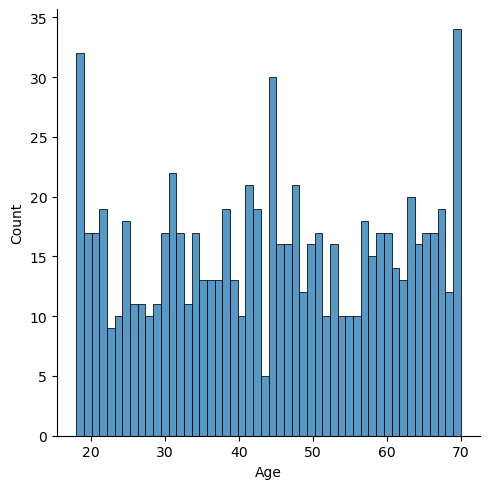

In [7]:
sns.displot(df_full['Age'],bins=50,palette='coolwarm')

In [309]:
df_full['Age'].iplot(kind='hist',bins=60,title='Customers By Age')

In [324]:
df_full.iplot(kind='bubble',x='Salary',y='Loan Amount',size='term amount',color='green',title='Analysing Loan Repayment Risk factor by Customers by Term Loan and Salary', xTitle='Salary', yTitle='Loan Amount')

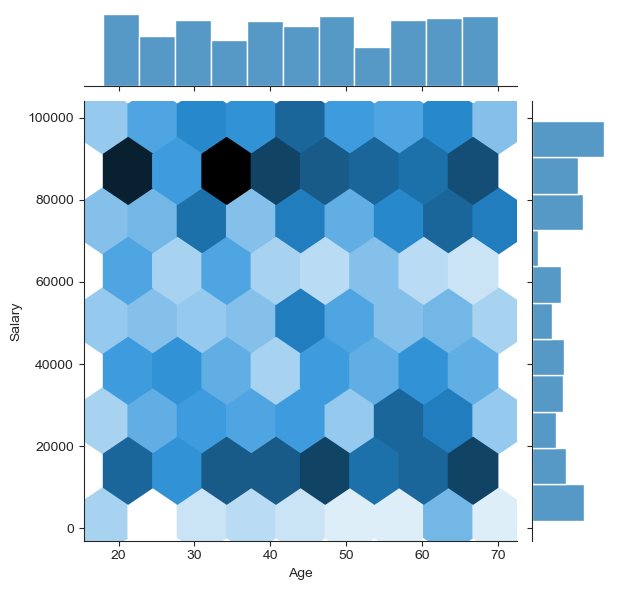

In [198]:
sns.set_style('ticks')
sns.jointplot(x='Age',y='Salary',data=df_full,kind='hex',palette='coolwarm',bins=100)

In [289]:
fig = make_subplots(rows=1,cols=2,subplot_titles=("Customers By Country", "Customers By Region"))
#df_full['Country'].value_counts().iplot(kind='bar',title='Customers By Country',ax=ax[0])
#df_full['Region'].value_counts().iplot(kind='bar',title="Customers By Region",ax=ax[1])
country_counts = df_full['Country'].value_counts()
fig.add_trace(go.Bar(x=country_counts.index, y=country_counts.values, name='Country'), row=1, col=1)

# Add bar plot for Customers By Region
region_counts = df_full['Region'].value_counts()
fig.add_trace(go.Bar(x=region_counts.index, y=region_counts.values, name='Region'), row=1, col=2)




In [270]:
df_full.iplot(kind='scatter',x='Salary',y='Loan Amount',mode='markers')

In [8]:
df_m = df_full['Marital Status'].value_counts()
df_m

Marital Status
Married      530
Unmarried    258
Name: count, dtype: int64

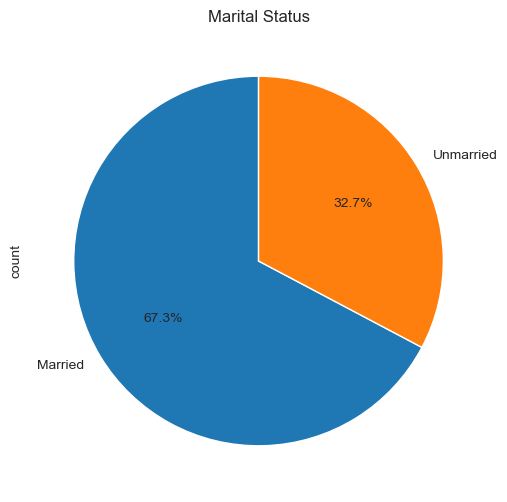

In [262]:
plt.figure(figsize=(10,6))
#df_m.plot(kind='pie',labels=['Married', 'Unmarried'], autopct='%1.1f%%', startangle=90)
df_m.plot(kind='pie', labels=['Married', 'Unmarried'], autopct='%1.1f%%', startangle=90)
plt.title('Marital Status')
plt.show()

In [94]:
ds_us=df_full[df_full['Country']=='United States'].reset_index()
ds_us.drop('index',axis=1,inplace=True)
ds_choro=ds_us[['Country','Home State','Loan Amount','Salary']].copy()
state_abbreviations = {
    'Alabama': 'AL',
    'Alaska': 'AK',
    'Arizona': 'AZ',
    'Arkansas': 'AR',
    'California': 'CA',
    'Colorado': 'CO',
    'Connecticut': 'CT',
    'Delaware': 'DE',
    'Florida': 'FL',
    'Georgia': 'GA',
    'Hawaii': 'HI',
    'Idaho': 'ID',
    'Illinois': 'IL',
    'Indiana': 'IN',
    'Iowa': 'IA',
    'Kansas': 'KS',
    'Kentucky': 'KY',
    'Louisiana': 'LA',
    'Maine': 'ME',
    'Maryland': 'MD',
    'Massachusetts': 'MA',
    'Michigan': 'MI',
    'Minnesota': 'MN',
    'Mississippi': 'MS',
    'Missouri': 'MO',
    'Montana': 'MT',
    'Nebraska': 'NE',
    'Nevada': 'NV',
    'New Hampshire': 'NH',
    'New Jersey': 'NJ',
    'New Mexico': 'NM',
    'New York': 'NY',
    'North Carolina': 'NC',
    'North Dakota': 'ND',
    'Ohio': 'OH',
    'Oklahoma': 'OK',
    'Oregon': 'OR',
    'Pennsylvania': 'PA',
    'Rhode Island': 'RI',
    'South Carolina': 'SC',
    'South Dakota': 'SD',
    'Tennessee': 'TN',
    'Texas': 'TX',
    'Utah': 'UT',
    'Vermont': 'VT',
    'Virginia': 'VA',
    'Washington': 'WA',
    'West Virginia': 'WV',
    'Wisconsin': 'WI',
    'Wyoming': 'WY'
}


ds_choro['Home State abb'] = ds_choro['Home State'].map(state_abbreviations)
#ds_choro['Loan Amount'] = ds_choro['Loan Amount'].apply(lambda x: f'{x / 1000:.1f}K')
ds_choro['Loan Amount'] = ds_choro['Loan Amount'].astype(int)
group_loan_us = ds_choro.groupby(['Home State','Home State abb'], as_index=False)['Loan Amount'].sum()
group_loan_us['Loan Amount'] = group_loan_us['Loan Amount'].apply(lambda x: f'{x / 1000000:.0f}M')
#group_loan_us['Loan Amount']=group_loan_us['Loan Amount'].astype(int)
group_loan_us


,Home State,Home State abb,Loan Amount
0,Alabama,AL,4M
1,Arizona,AZ,6M
2,California,CA,41M
3,Colorado,CO,4M
4,Connecticut,CT,2M
5,Delaware,DE,3M
6,Florida,FL,9M
7,Georgia,GA,6M
8,Illinois,IL,16M
9,Indiana,IN,4M


In [90]:
data=dict(type='choropleth',
    locations=group_loan_us['Home State abb'],  
    z=group_loan_us['Loan Amount'], 
    text=group_loan_us['Home State'],    
    locationmode='USA-states', 
    colorbar= {'title':'Average Loan Amount by USA' },      
    colorscale='Greens',
    marker = dict(line =dict(color ='rgb(255,255,255)',width=2)),
    reversescale=True,           
    colorbar_title='Average Loan by USA',
)


layout=dict(title='Average Loan By USA States',geo= dict(scope='usa',showlakes=True,lakecolor='rgb(85,173,240)'))
choromap=go.Figure(data=[data],layout=layout)
iplot(choromap)

In [33]:
ds_ind=df_full[df_full['Country']=='India'].reset_index()
ds_ind.drop('index',axis=1,inplace=True)
ds_inch=ds_ind[['Country','Home State','Loan Amount','Salary']].copy()
state_abbreviations_india = {
    'Andhra Pradesh': 'AP',
    'Arunachal Pradesh': 'AR',
    'Assam': 'AS',
    'Bihar': 'BR',
    'Chhattisgarh': 'CG',
    'Goa': 'GA',
    'Gujarat': 'GJ',
    'Haryana': 'HR',
    'Himachal Pradesh': 'HP',
    'Jharkhand': 'JH',
    'Karnataka': 'KA',
    'Kerala': 'KL',
    'Madhya Pradesh': 'MP',
    'Maharashtra': 'MH',
    'Manipur': 'MN',
    'Meghalaya': 'ML',
    'Mizoram': 'MZ',
    'Nagaland': 'NL',
    'Odisha': 'OR',
    'Punjab': 'PB',
    'Rajasthan': 'RJ',
    'Sikkim': 'SK',
    'Tamil Nadu': 'TN',
    'Telangana': 'TG',
    'Tripura': 'TR',
    'Uttar Pradesh': 'UP',
    'Uttarakhand': 'UK',
    'West Bengal': 'WB',
    'Andaman and Nicobar Islands': 'AN',
    'Chandigarh': 'CH',
    'Dadra and Nagar Haveli and Daman and Diu': 'DN',
    'Lakshadweep': 'LD',
    'Delhi': 'DL',
    'Puducherry': 'PY',
}
ds_inch['Home State abb'] = ds_inch['Home State'].map(state_abbreviations_india)
ds_inch.dropna(subset='Home State',inplace=True)
ds_inch.reset_index(inplace=True)
ds_inch.drop('index',axis=1,inplace=True)
ds_inch.dropna(subset='Loan Amount',inplace=True)
ds_inch

,Country,Home State,Loan Amount,Salary,Home State abb
0,India,Tamil Nadu,840151,45231,TN
1,India,Bihar,84679,94110,BR
2,India,Gujarat,109913,90301,GJ
3,India,Karnataka,1026085,19140,KA
4,India,Kerala,1024945,90004,KL
...,...,...,...,...,...
259,India,West Bengal,1144667,43615,WB
260,India,Tamil Nadu,107441,94122,TN
261,India,Bihar,120053,78521,BR
262,India,Gujarat,1000589,90008,GJ


In [84]:
group_loan_ind = ds_inch.groupby('Home State', as_index=False)['Loan Amount'].sum()
group_loan_ind['Loan Amount'] = group_loan_ind['Loan Amount'].apply(lambda x: f'{x / 1000000:.0f}M')
#group_loan_ind['Loan Amount']=group_loan_ind['Loan Amount'].astype(int)
group_loan_ind

,Home State,Loan Amount
0,Bihar,16M
1,Goa,18M
2,Gujarat,18M
3,Jammu and Kashmir,17M
4,Karnataka,19M
5,Kerala,16M
6,Maharastra,11M
7,Tamil Nadu,17M
8,Telangana,16M
9,West Bengal,16M


In [80]:
with open(r'C:\Users\Kathir\Downloads\Python_data_cleaning\states_india.geojson') as f:
    geojson_data = json.load(f)
data1=dict(type='choropleth',
    geojson=geojson_data,
    locations=group_loan_ind['Home State'],  
    z=group_loan_ind['Loan Amount'], 
    text=group_loan_ind['Home State'],
    featureidkey= 'properties.st_nm',           
    colorscale='portland', 
    marker = dict(line =dict(color ='rgb(255,255,255)',width=2)),         
    colorbar_title='Average Loan by India',
)


layout1=dict( geo=dict(
        center=dict(lat=22.5937, lon=78.9629),  # Center on India
        projection_scale=5,                    # Zoom level
        showland=True,                         # Show land
        landcolor='rgb(217, 217, 217)',        # Color of land
    ))
choromap1=go.Figure(data=[data1],layout=layout1)
iplot(choromap1)

In [102]:
df_col=df_full.groupby('Country',as_index=False)['Loan Amount'].sum()
df_col['Loan Amount'] = df_col['Loan Amount'].apply(lambda x: f'{x / 1000000:.0f}')
df_col['Loan Amount']=df_col['Loan Amount'].astype(int)
df_col

,Country,Loan Amount
0,Germany,91
1,India,166
2,United States,235


In [109]:
data2=dict(type='choropleth',
    locations=df_col['Country'],  
    z=df_col['Loan Amount'], 
    text=df_col['Country'],    
    locationmode='country names', 
    colorbar= {'title':'Average Loan Amount by USA' },      
    colorscale='Spectral',
    marker = dict(line =dict(color ='rgb(255,255,255)',width=2)),
    reversescale=True,           
    colorbar_title='Average Loan by country Denoted in Milions',
)


layout2=dict(title='Average Loan By Country',geo=dict(
        showlakes=True, 
        lakecolor='rgb(85,173,240)', 
        projection=dict(type='natural earth')))
choromap=go.Figure(data=[data2],layout=layout2)
iplot(choromap)


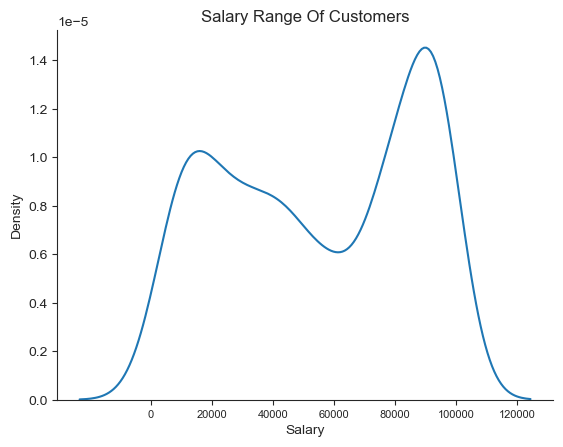

In [228]:
sns.kdeplot(df_full['Salary'])
plt.title('Salary Range Of Customers')
plt.xlabel('Salary')
plt.xticks([0,20000,40000,60000,80000,100000,120000],fontsize=8, rotation=0)
sns.despine()
plt.show()

In [140]:
df_region=df_full.pivot_table(index=['Country','Region'],values='Salary',aggfunc={'Salary':['mean','median','min','max']})
#df_hm=df_full.pivot_table(index='Country',values=['Salary','Loan Amount','term amount'])
df_region

max          mean   median    min
Country       Region                                      
Germany       Central  98502  55690.214286  51817.0   8302
              East     98661  53206.755102  49201.0   1841
              South    94601  64703.882353  77070.0  19120
              West     98115  59445.959184  75019.0  10009
India         Central  98270  45416.985915  40214.0   7036
              East     98115  54699.605263  61251.0   1841
              South    94521  61473.432432  77036.0  10024
              West     98661  51259.087500  48205.0   1841
United States Central  98115  55157.091837  55503.5   1852
              East     99207  56728.214286  60616.5   1841
              South    98115  54306.886792  47201.0   8701
              West     98115  59081.863636  62111.0   2169

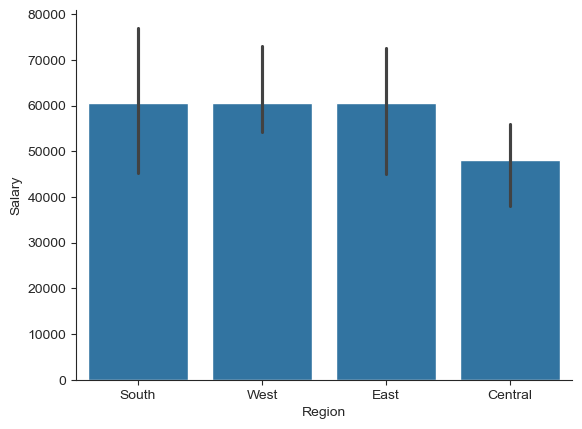

In [187]:
sns.barplot(x='Region',y='Salary',data=df_full,estimator='median')
sns.despine()

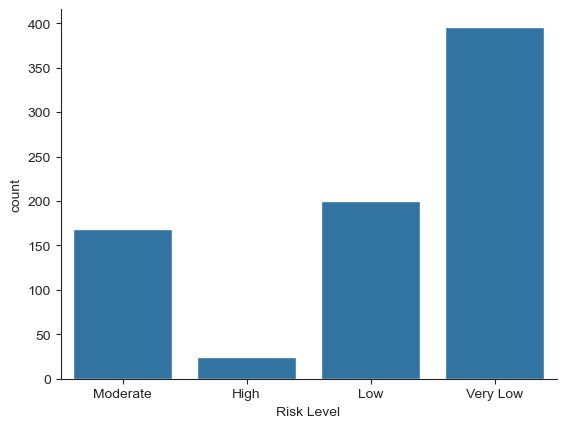

In [186]:
sns.countplot(x='Risk Level',data=df_full)
sns.despine()

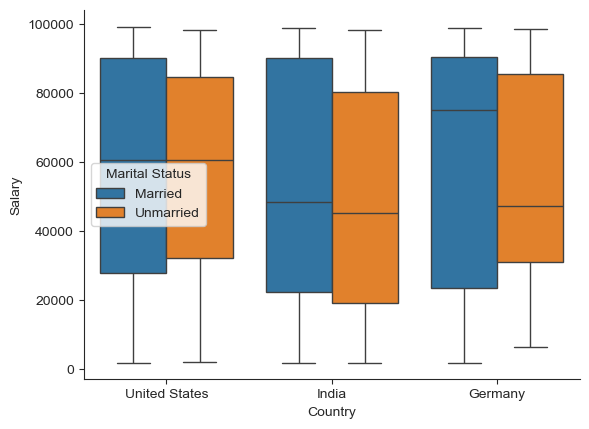

In [185]:
sns.boxplot(x='Country',y='Salary',data=df_full,hue='Marital Status',legend=True)
sns.despine()

<Axes: xlabel='Country', ylabel='Salary'>

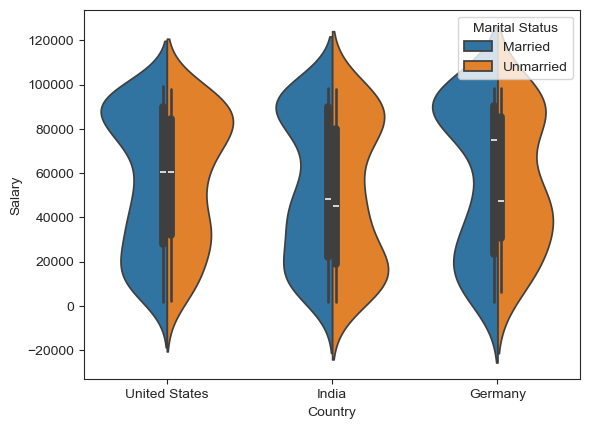

In [242]:
#sns.factorplot(kind='')
sns.violinplot(x='Country',y='Salary',data=df_full,hue='Marital Status',split=True,legend=True)

In [204]:
df_af=df_full.pivot_table(index='Country',columns='Type of Loan',values='Customer ID',aggfunc={'Customer ID':'count'})
df_af

Type of Loan,Gold Loan,Home Loan,Personal Loan,Vehicle Loan
Country,,,,
Germany,24,88,26,5
India,53,153,51,7
United States,66,221,75,19


<Axes: xlabel='Type of Loan', ylabel='Country'>

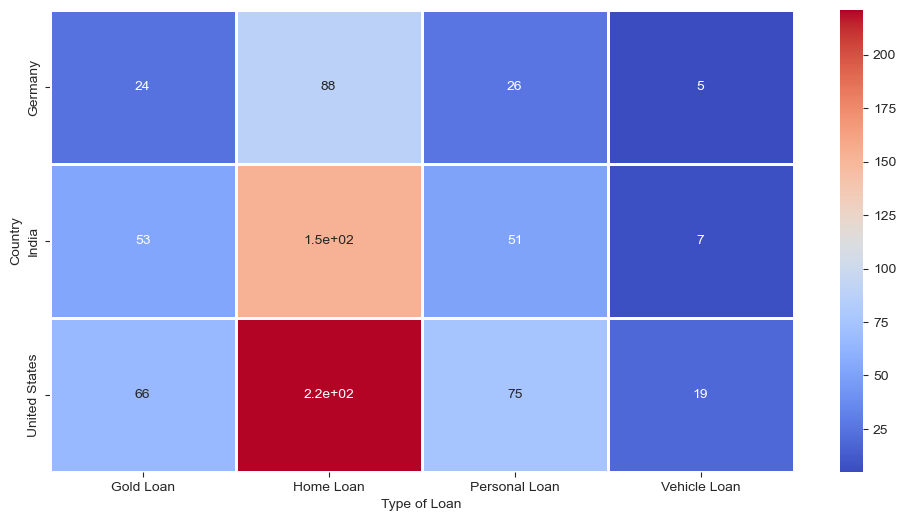

In [193]:
plt.figure(figsize=[12,6])
sns.heatmap(df_af,annot=True,cmap='coolwarm',lw=1,linecolor='white')

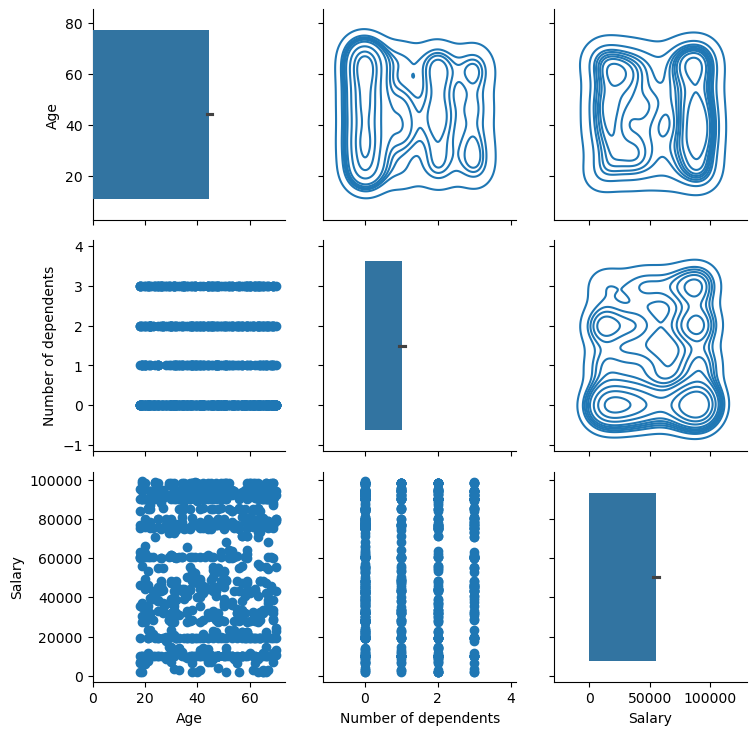

In [164]:
g=sns.PairGrid(customer_data)
g.map_diag(sns.barplot)
g.map_lower(plt.scatter)
g.map_upper(sns.kdeplot)

<Figure size 400x600 with 0 Axes>

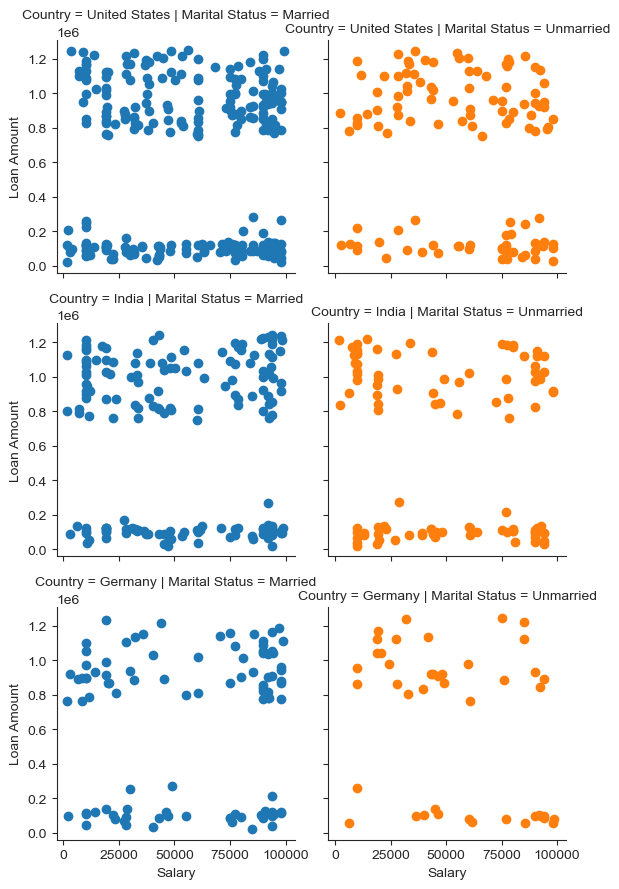

In [190]:
g=sns.FacetGrid(data=df_full,col='Marital Status',row='Country',hue='Marital Status')
g.map(plt.scatter,'Salary','Loan Amount')

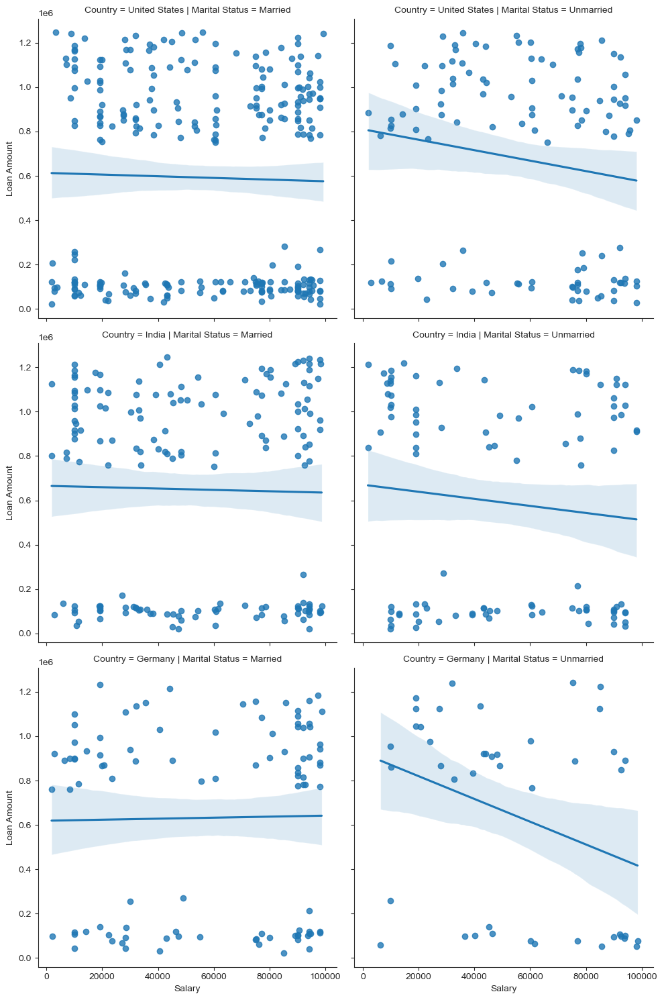

In [274]:
sns.set_style('ticks')
sns.lmplot(x='Salary',y='Loan Amount',data=df_full,col='Marital Status',row='Country')

c:\Users\Kathir\anaconda3\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Kathir\anaconda3\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Kathir\anaconda3\Lib\site-packages\seaborn\axisgrid.py:1615: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Kathir\anaconda3\Lib\site-packages\seaborn\axisgrid.py:1615: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



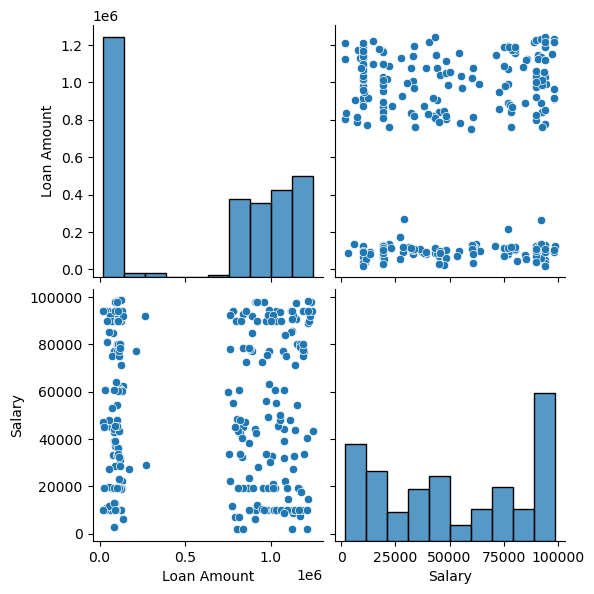

In [108]:
sns.pairplot(ds_inch,height=3,palette='coolwarm')

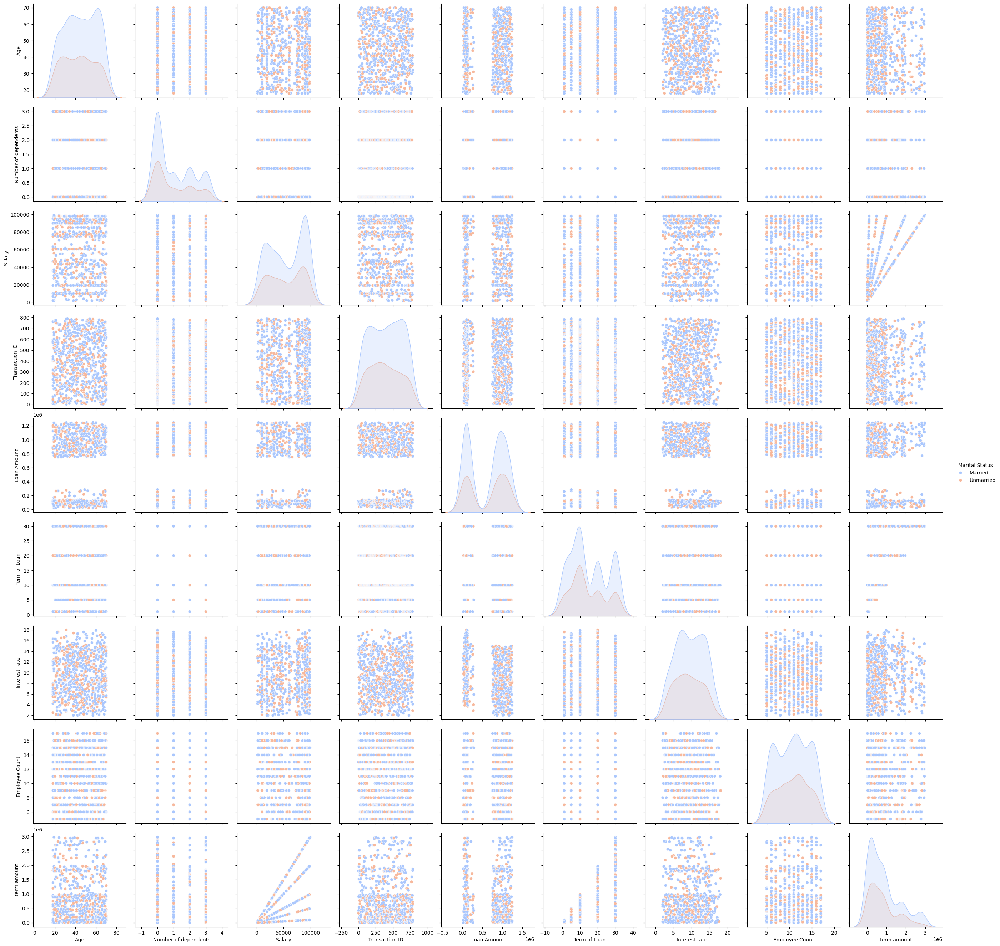

In [106]:
sns.pairplot(df_full,height=3,hue='Marital Status',palette='coolwarm')